In [3]:

import numpy as np
import cv2
from PIL import Image
import re
import fastai
from fastai.vision import *
from fastai.callbacks import *
from fastai.vision.gan import *
from google.colab.patches import cv2_imshow

import glob

ModuleNotFoundError: No module named 'fastai.callbacks'

In [4]:
#!pip install opencv-python 
#!pip install google
#!pip install fastai
#!pip install fastai.callbacks

ERROR: Could not find a version that satisfies the requirement fastai.callbacks (from versions: none)
ERROR: No matching distribution found for fastai.callbacks


In [ ]:
img = cv2.imread("/content/Scientist.jpg")

In [ ]:
  

  crap_index = np.random.binomial(1, 0.5, 1) # 0 = cv2.INTER_LINEAR  1 = cv2.INTER_AREA

  n, m, z = img.shape

  if(crap_index == 0):
    img_resize = cv2.resize(img, (224, 224), interpolation = cv2.INTER_LINEAR)
    img_resize = cv2.resize(img_resize, tuple(reversed(img.shape[0:2])), interpolation = cv2.INTER_LINEAR)

  else:
    img_resize = cv2.resize(img, (224, 224), interpolation = cv2.INTER_AREA)
    img_resize = cv2.resize(img_resize, tuple(reversed(img.shape[0:2])), interpolation = cv2.INTER_AREA)

  rect_index = np.random.binomial(1, 0.05, 1) # 0 = No_rect  1 = Yes_rect

  if(rect_index == 1):
    rect_start_point = (np.random.randint(0, n, 1), np.random.randint(0, m, 1))
    rect_end_point = (rect_start_point[0] + np.random.randint(0, 50, 1), rect_start_point[1] + np.random.randint(0, 50, 1))
    img_draw = cv2.rectangle(img_resize, rect_start_point, rect_end_point, (255, 255, 255), -1)

    img_resize = img_draw

  text_index = np.random.binomial(1, 0.1, 1)

  if(text_index == 1):
    text = str(int(np.random.randint(0, 100, 1)))
    text_start_point = (np.random.randint(0, n, 1), np.random.randint(0, m, 1))
    img_text = cv2.putText(img_resize, text, text_start_point, cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 10)

    img_resize = img_text


  #img_name = (re.search(r'/(\d+)', str(fname)).group()) + ".jpg"

  #dest = str(dest) + str(img_name)

  quality = np.random.randint(20, 80)

In [ ]:
def MSE(img1, img2): 
  return(np.mean((img1-img2)**2))

In [ ]:
MSE(img, img_resize)

34.448466710519995

In [ ]:
img = cv2.imread("/content/shitty.jpg")

# Define a crappify function

In [ ]:
pth = Path("/content/drive/My Drive")
pth_high_res = pth/"flickr30k_images"
pth_low_res = pth/"shitty_images_folder"

In [ ]:
def crappify(fname, index): #index is for nothing, just there so we can use parallel

  #dest = "/content/shitty_images_folder"

  dest = pth_low_res/fname.relative_to(pth_high_res)
  dest.parent.mkdir(parents = True, exist_ok = True)

  img = cv2.imread(str(fname), cv2.IMREAD_COLOR)

  crap_index = np.random.binomial(1, 0.5, 1) # 0 = cv2.INTER_LINEAR  1 = cv2.INTER_AREA

  n, m, z = img.shape

  if(crap_index == 0):
    img_resize = cv2.resize(img, (224, 224), interpolation = cv2.INTER_LINEAR)
    img_resize = cv2.resize(img_resize, tuple(reversed(img.shape[0:2])), interpolation = cv2.INTER_LINEAR)

  else:
    img_resize = cv2.resize(img, (224, 224), interpolation = cv2.INTER_AREA)
    img_resize = cv2.resize(img_resize, tuple(reversed(img.shape[0:2])), interpolation = cv2.INTER_AREA)

  rect_index = np.random.binomial(1, 0.05, 1) # 0 = No_rect  1 = Yes_rect

  if(rect_index == 1):
    rect_start_point = (np.random.randint(0, n, 1), np.random.randint(0, m, 1))
    rect_end_point = (rect_start_point[0] + np.random.randint(0, 50, 1), rect_start_point[1] + np.random.randint(0, 50, 1))
    img_draw = cv2.rectangle(img_resize, rect_start_point, rect_end_point, (255, 255, 255), -1)

    img_resize = img_draw

  text_index = np.random.binomial(1, 0.1, 1)

  if(text_index == 1):
    text = str(int(np.random.randint(0, 100, 1)))
    text_start_point = (np.random.randint(0, n, 1), np.random.randint(0, m, 1))
    img_text = cv2.putText(img_resize, text, text_start_point, cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 10)

    img_resize = img_text


  img_name = (re.search(r'/(\d+)', str(fname)).group()) + ".jpg"

  #dest = str(dest) + str(img_name)

  quality = np.random.randint(20, 80)
  cv2.imwrite(str(dest), img_resize, [int(cv2.IMWRITE_JPEG_QUALITY), quality])

  #return(img_resize)  
  


In [ ]:
dest = "/content/shitty_images_folder"

In [ ]:
#crappify("/content/drive/My Drive/flickr30k_images/205842.jpg")

In [ ]:
#cv2_imshow(img_new)

# Make high res image shitty

In [ ]:
item_list = ImageList.from_folder("/content/drive/My Drive/flickr30k_images")

In [ ]:
dest = "/content/shitty_images_folder"

In [ ]:
item_list.items[0:10]

array([PosixPath('/content/drive/My Drive/flickr30k_images/846085364.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/83575794.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/84507882.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/840202638.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/841397013.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/82679989.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/843218288.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/847782643.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/829798661.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/851566221.jpg')], dtype=object)

In [ ]:
#crappify(item_list.items[0], 0)

In [ ]:
#parallel(crappify, item_list.items, max_workers = 16)

# Pre-trained Generator

In [ ]:
# pth_high_res = Path('/content/drive/My Drive/flickr30k_images')
# pth_low_res = Path('/content/shitty_images_folder')

In [ ]:
arch = models.resnet34
bs, size = 16, 256

In [ ]:
size

256

In [ ]:
def get_data(bs, size): 
  data = (ImageImageList.from_folder(pth_low_res)
          .split_by_rand_pct(0.1, seed = 152)
          .label_from_func(lambda x :pth_high_res/x.name)
          .transform(get_transforms(max_zoom = 2.0), size = size, tfm_y = True)
          .databunch(bs=bs)
          .normalize(imagenet_stats, do_y = True))
  
  data.c = 3

  return(data)


In [ ]:
data_gen = get_data(bs, size = size)

In [ ]:
data_gen

ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None

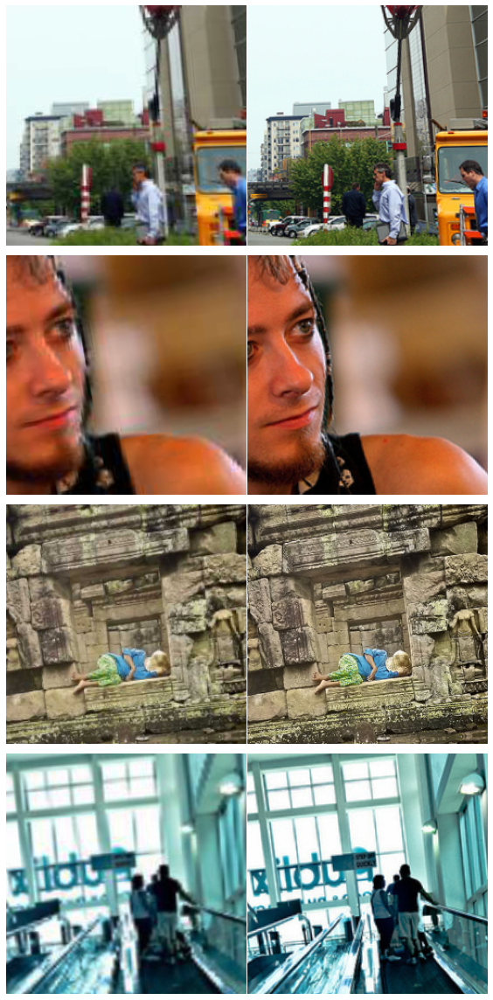

In [ ]:
data_gen.show_batch(4)

In [ ]:
wd = 1e-3

In [ ]:
y_range = (-3.0, 3.0)

In [ ]:
loss_gen = MSELossFlat()

In [ ]:
def create_gen_learner():
  return unet_learner(data_gen, 
                      arch, 
                      wd = wd, 
                      blur = True, 
                      norm_type = NormType.Weight, 
                      self_attention = True, 
                      y_range = y_range, 
                      loss_func = loss_gen)

In [ ]:
learner_gen = create_gen_learner()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


We still use pre-trained model because there are some blank or numbers in the picture, we need to know what probably was there since we would like to fill those blanks.

So let's know a pre-trained models that knows this kind of thing

```
blur = True, 
norm_type = NormType.Weight, 
self_attention = True, 
```

These three things are useful, but we are not going to talk about that

In [ ]:
learner_gen.fit_one_cycle(2, pct_start = 0.8)

epoch,train_loss,valid_loss,time
0,0.048377,0.047710,3:16:10
1,0.041037,0.038181,3:21:06


In [ ]:
learner_gen.save("/content/drive/My Drive/models/generator-1")

In [ ]:
learner_gen.load("/content/drive/My Drive/models/generator-1")

Learner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1,

In [ ]:
gc.collect()
learner_gen.unfreeze()

In [ ]:
learner_gen.fit_one_cycle(2, slice(1e-6, 1e-3))

epoch,train_loss,valid_loss,time
0,0.041053,0.038176,4:35:21
1,0.037622,0.037516,4:41:18


In [ ]:
learner_gen.save("/content/drive/My Drive/models/generator-2")

With this training, we know how to remove those number, which is good.

In [ ]:
learner_gen.load("/content/drive/My Drive/models/generator-2")

Learner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1,

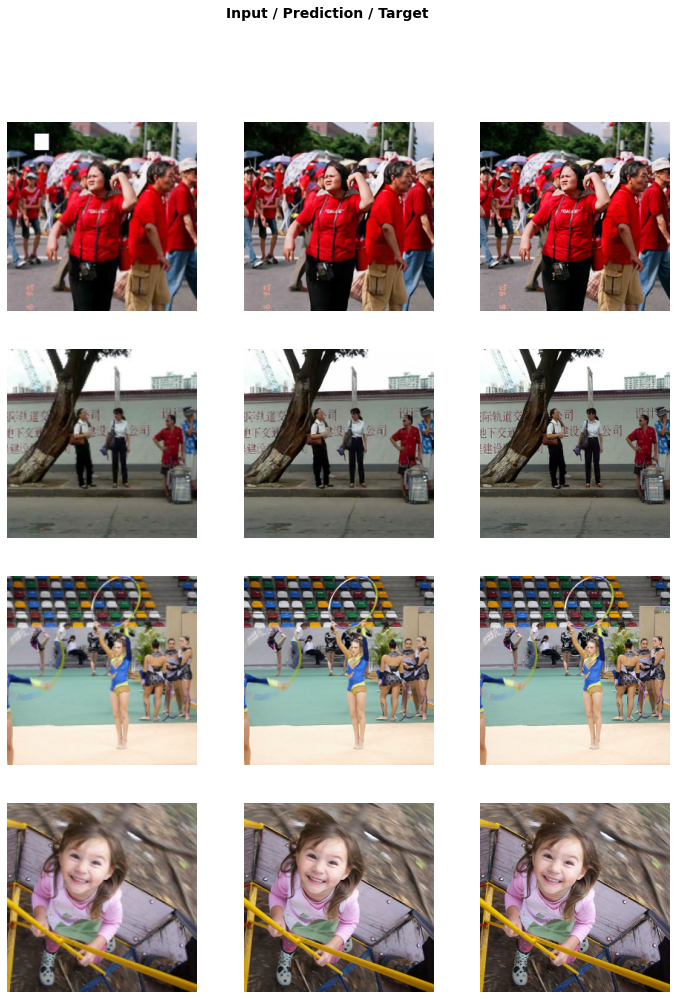

In [ ]:
learner_gen.show_results(rows = 4)

# Save Generated images

But we are not finishing, we still have to solve super resolution problem.

The reason why we did not solve this problem through U-net is that the loss function didn't describe what we want.

MSE between shitty picture and high res picture is actually really small since the color of the same location is not that different.

Thus we want another loss function to do better, there's a general way to do this, which is GAN.

Our loss function is another model, call descriminator, or critic. This is a regular cross entrophy classifier.

So the thing is how good are to fool the critic.

But the critic is not that great, if generator is good, it will fool the critic.

We start train critic, which is better than generotor. Than we start train gen, makes it better than critic, and we do this procedure over and over.

This is Jeremy Howard's trick to build a GAN. Pre-train the generator, and pre-train the critic.

This will cause a lot of pain, but if we don't pretrain, than it will be like blind leading the blind.

We need two folders, one is high res images, the other is generated images

In [ ]:
name_gen = "image_gen"
path_gen = pth/name_gen

In [ ]:
path_gen.mkdir(exist_ok = True)

In [ ]:
len(data_gen.fix_dl.dataset.items)

28609

In [ ]:
def save_pred(dl):
  i = 0
  names = dl.dataset.items

  for b in dl:
    preds = learner_gen.pred_batch(batch = b, reconstruct = True)

    for o in preds:
      o.save(path_gen/names[i].name)
      i += 1



In [ ]:
#save_pred(data_gen.fix_dl)

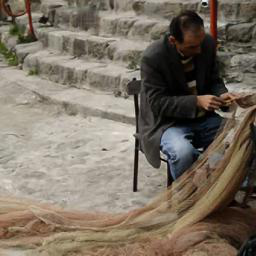

In [ ]:
PIL.Image.open(path_gen.ls()[0])

# Train critic

Clean the GPU mem

In [ ]:
learner_gen = None
gc.collect()

7

Now, we are not going to use resnet CNN. 

We just going to use a binary learner, which will identify which is image_gen, which is original high_res image.

## Dataset

In [ ]:
def get_critic_data(classes, bs, size):
  data = (ImageList.from_folder(pth, include = classes)
          .split_by_rand_pct(0.1, seed = 152)
          .label_from_folder(classes = classes)
          .transform(get_transforms(max_zoom = 2.0), size = size)
          .databunch(bs = bs)
          .normalize(imagenet_stats))
  
  data.c = 3
  

  return(data)

In [ ]:
pth

PosixPath('/content/drive/My Drive')

In [ ]:
name_gen

'image_gen'

In [ ]:
bs = 16
size = 256

In [ ]:
data_crit = get_critic_data(classes = [name_gen, "flickr30k_images"], bs = bs, size = size)

In [ ]:
data_crit.items

array([PosixPath('/content/drive/My Drive/flickr30k_images/846085364.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/83575794.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/84507882.jpg'),
       PosixPath('/content/drive/My Drive/flickr30k_images/840202638.jpg'), ...,
       PosixPath('/content/drive/My Drive/image_gen/1082478946.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/1092437557.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/109083036.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/1044764620.jpg')], dtype=object)

In [ ]:
data_crit

ImageDataBunch;

Train: LabelList (54357 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images
Path: /content/drive/My Drive;

Valid: LabelList (6039 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
image_gen,flickr30k_images,flickr30k_images,image_gen,flickr30k_images
Path: /content/drive/My Drive;

Test: None

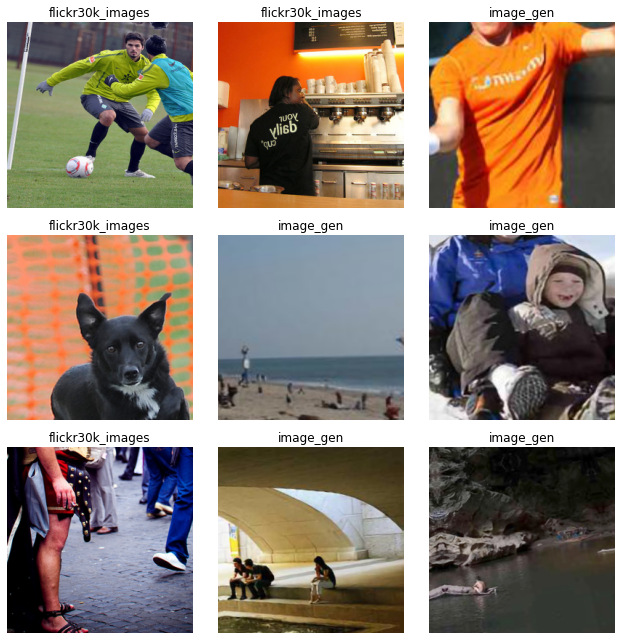

In [ ]:
data_crit.show_batch(rows = 3, ds_type = DatasetType.Train, imgsize = 3)

In [ ]:
loss_critic = AdaptiveLoss(nn.BCEWithLogitsLoss())

In [ ]:
def create_critic_learner(data, metric):
  return( Learner(data, gan_critic(), metrics = metric, loss_func = loss_critic, wd = wd) )

In [ ]:
learn_critic = create_critic_learner(data_crit, accuracy_thresh_expand)

In [ ]:
gc.collect()

0

## Train

### Full data

#### 1st epoch

Choose full data to train 1 epoch

In [ ]:
learn_critic.fit_one_cycle(1, 1e-3)

epoch,train_loss,valid_loss,accuracy_thresh_expand,time
0,0.302604,0.814555,0.611220,7:32:21


In [ ]:
learn_critic.summary()

Sequential
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [128, 128, 128]      6,272      True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
______________________________________________________________________
Dropout2d            [128, 128, 128]      0          False     
______________________________________________________________________
Conv2d               [128, 128, 128]      147,584    True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
______________________________________________________________________
Conv2d               [128, 128, 128]      147,584    True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
___________________________________________________

In [ ]:
learn_critic.save("/content/drive/My Drive/models/discriminator-1")

#### 2nd epoch

In [ ]:
learn_critic.load("/content/drive/My Drive/models/discriminator-1")

Learner(data=ImageDataBunch;

Train: LabelList (54357 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images
Path: /content/drive/My Drive;

Valid: LabelList (6039 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
image_gen,flickr30k_images,flickr30k_images,image_gen,flickr30k_images
Path: /content/drive/My Drive;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (1): Dropout2d(p=0.075, inplace=False)
  (2): SequentialEx(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2, inplace=True)
 

In [ ]:
learn_critic.unfreeze()

In [ ]:
learn_critic.fit_one_cycle(1, 5e-4)

epoch,train_loss,valid_loss,accuracy_thresh_expand,time
0,0.251174,0.877762,0.617239,7:19:45


In [ ]:
learn_critic.save("/content/drive/My Drive/models/discriminator-1")

### Partial data

I found out if I reduce the number of data in image_gen and flickr30k_images, I can reduce the databunch and accelerate the training speed.

#### Dataset

In [ ]:
path_local = Path("/content")
name_gen = "image_gen"
name_flickr = "flickr"
path_local_gen = path_local/name_gen
path_local_flickr = path_local/name_flickr

In [ ]:
path_local_gen.mkdir(exist_ok = True)
path_local_flickr.mkdir(exist_ok = True)

In [ ]:
path_gen

PosixPath('/content/drive/My Drive/image_gen')

In [ ]:
path_local_gen

PosixPath('/content/image_gen')

In [ ]:
item_list = ItemList.from_folder(str(path_gen))

In [ ]:
item_list.items

array([PosixPath('/content/drive/My Drive/image_gen/7598946.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/7633434714.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/7656601.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/7654089948.jpg'), ...,
       PosixPath('/content/drive/My Drive/image_gen/109083036.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/1044764620.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/1080230428.jpg'),
       PosixPath('/content/drive/My Drive/image_gen/1035019794.jpg')], dtype=object)

In [ ]:
def copy_to_local_partial(img_path):

  path = str(img_path)
  img_name = (re.search(r'(\d+)', str(img_path)).group()) + ".jpg"
  flickr_name = Path("/content/drive/My Drive/flickr30k_images")/img_name


  dest_pth_gen = path_local_gen/img_name
  dest_pth_flickr = path_local_flickr/img_name

  save_or_not = np.random.binomial(1, 0.1, 1)
  

  if(save_or_not == 1):
    open_image(path).save(dest_pth_gen)
    open_image(flickr_name).save(dest_pth_flickr)

    


In [ ]:
#copy_to_local_partial(item_list.items[0])

In [ ]:
i = 0
n = len(item_list.items)
for i in range(n):
  copy_to_local_partial(img_path = item_list.items[i])

  if(i % 1200 == 0):
    print("Completeness: " + str(100*i/n) + "%")

Completeness: 0.0%
Completeness: 4.194484253207032%
Completeness: 8.388968506414065%
Completeness: 12.583452759621098%
Completeness: 16.77793701282813%
Completeness: 20.972421266035163%
Completeness: 25.166905519242196%
Completeness: 29.36138977244923%
Completeness: 33.55587402565626%
Completeness: 37.750358278863295%
Completeness: 41.944842532070325%
Completeness: 46.13932678527736%
Completeness: 50.33381103848439%
Completeness: 54.52829529169143%
Completeness: 58.72277954489846%
Completeness: 62.917263798105495%
Completeness: 67.11174805131252%
Completeness: 71.30623230451955%
Completeness: 75.50071655772659%
Completeness: 79.69520081093363%
Completeness: 83.88968506414065%
Completeness: 88.08416931734769%
Completeness: 92.27865357055472%
Completeness: 96.47313782376175%


In [ ]:
len(ItemList.from_folder("/content/image_gen").items)


In [ ]:
pth

In [ ]:
def get_critic_data_partial(classes, bs, size):
  pth = Path("/content")
  data = (ImageList.from_folder(pth, include = classes)
          .split_by_rand_pct(0.1, seed = 152)
          .label_from_folder(classes = classes)
          .transform(get_transforms(max_zoom = 2.0), size = size)
          .databunch(bs = bs)
          .normalize(imagenet_stats))
  
  data.c = 3
  

  return(data)

In [ ]:
name_gen

'image_gen'

In [ ]:
data_crit = get_critic_data_partial(classes = [name_gen, "flickr"], bs = bs, size = size)

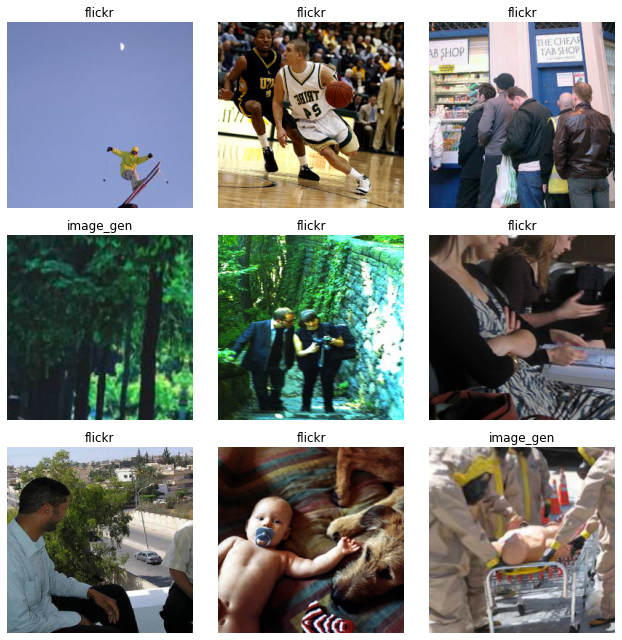

In [ ]:
data_crit.show_batch(rows = 3, ds_type = DatasetType.Train, imgsize = 3)

In [ ]:
loss_critic = AdaptiveLoss(nn.BCEWithLogitsLoss())

In [ ]:
learn_critic = create_critic_learner(data_crit, accuracy_thresh_expand)

In [ ]:
gc.collect()

456

#### Second stage

In [ ]:
learn_critic.load("/content/drive/My Drive/models/discriminator-1")

Learner(data=ImageDataBunch;

Train: LabelList (10356 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
flickr,flickr,flickr,flickr,flickr
Path: /content;

Valid: LabelList (1150 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
flickr,flickr,image_gen,image_gen,flickr
Path: /content;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (1): Dropout2d(p=0.075, inplace=False)
  (2): SequentialEx(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (1): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

In [ ]:
learn_critic.unfreeze()

In [ ]:
learn_critic.lr_find()

epoch,train_loss,valid_loss,accuracy_thresh_expand,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


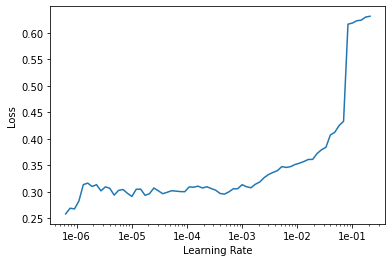

In [ ]:
learn_critic.recorder.plot()

In [ ]:
learn_critic.fit_one_cycle(4, 5e-5)

In [ ]:
learn_critic.save("/content/drive/My Drive/models/discriminator-1")

# GAN

After we pre-train generator and discriminator, we can finally start using GAN to make it possible.

When we using GAN, we should be particular careful that the generator and the critic are both pushing the same direction, increasing the weights to make it out of control, thus we are not going to use resnet. We have to use some spectral normalization to make GANs work today, long story for short, if we use ```gan_critic()```, fastai will give us the better model for GAN. It is rather safe not to use resnet here.

Now we have pre-train generator and pre-train critic, need to like ping-pong train between each

In [ ]:
learn = None

In [ ]:
learn_critic = None
learner_gen = None
data_gen = None

In [ ]:
gc.collect()

0

In [ ]:
bs = 32

In [ ]:
data_crit = get_critic_data(classes = [name_gen, "flickr30k_images"], bs = bs, size = size)

In [ ]:
data_gen = get_data(bs, size = size)

In [ ]:
learn_crit = create_critic_learner(data_crit, metric = None).load("/content/discriminator-1")

In [ ]:
learner_gen = create_gen_learner().load("/content/generator-2")

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


In [ ]:
switcher = partial(AdaptiveGANSwitcher, critic_thresh = 0.70) #0.70 after epoch 5, 0.65 in others

learn = GANLearner.from_learners(learner_gen, 
                                 learn_crit, 
                                 weights_gen = (1.0, 50.0), 
                                 show_img =  True, 
                                 switcher = switcher, 
                                 opt_func = partial(optim.Adam, betas = (0., 0.99)), 
                                 wd = wd)

learn.callback_fns.append(partial(GANDiscriminativeLR, mult_lr = 5.0 ))

In [ ]:
lr = 1e-4

In [ ]:
learn_crit.data

ImageDataBunch;

Train: LabelList (54357 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images,flickr30k_images
Path: /content/drive/My Drive;

Valid: LabelList (6039 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
image_gen,flickr30k_images,flickr30k_images,image_gen,flickr30k_images
Path: /content/drive/My Drive;

Test: None

In [ ]:
learn.data

ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None

One of the hard thing of GAN is that it is hard to see whats going on there, so we have to train a little bit, and see how it goes, the numbers are meaningless.

Also, the training time is very long, I have to train it epoch by epoch.

## First epoch

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.613919,1.716524,2.963852,0.623109,8:37:28


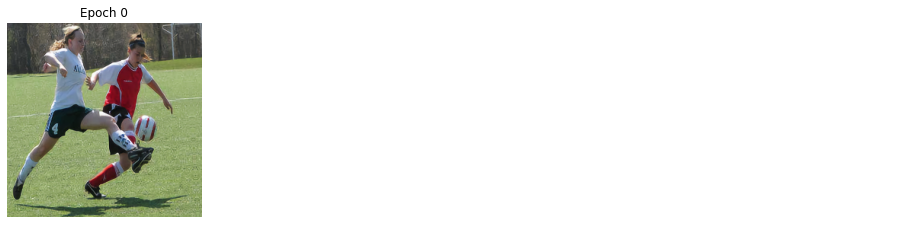

In [ ]:
learn.fit(1, lr)

In [ ]:
learn.save("/content/SRGAN-1")

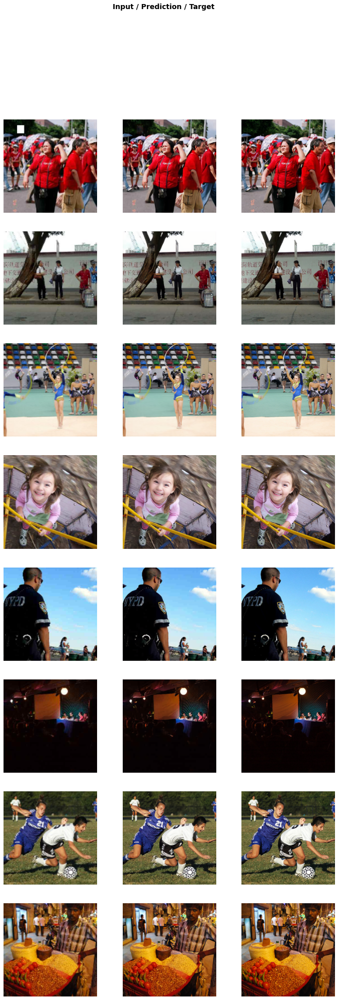

In [ ]:
learn.show_results(rows = 8)

## Second epoch

### Predict a little bit

In [ ]:
learn.load("/content/SRGAN-1")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

In [ ]:
learn.summary()

GANModule
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [128, 128, 128]      6,272      True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
______________________________________________________________________
Dropout2d            [128, 128, 128]      0          False     
______________________________________________________________________
Conv2d               [128, 128, 128]      147,584    True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
______________________________________________________________________
Conv2d               [128, 128, 128]      147,584    True      
______________________________________________________________________
LeakyReLU            [128, 128, 128]      0          False     
____________________________________________________

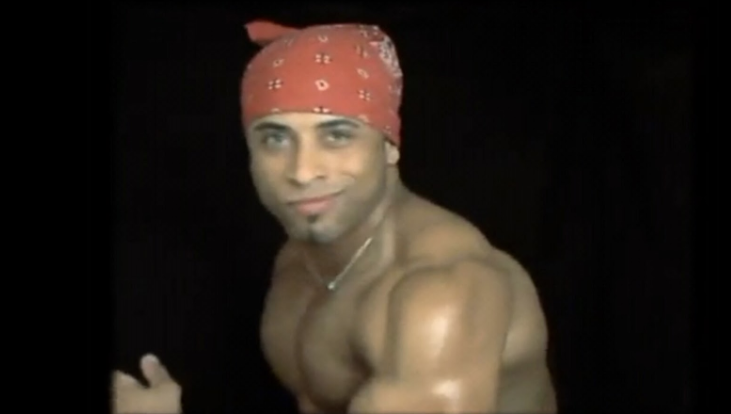

In [ ]:
img = open_image("/content/ricardo.png")
#img = open_image("/content/Billy_Sample.png")
original_size = img.shape
img

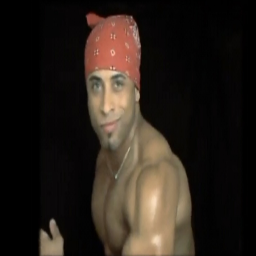

In [ ]:
img.resize((3, 256, 256))

SR one time

In [ ]:
learn.gen_mode = True
pred = learner_gen.predict(img)

In [ ]:
img = pred[0]

In [ ]:
original_size

torch.Size([3, 414, 731])

In [ ]:
img = img.resize(original_size)

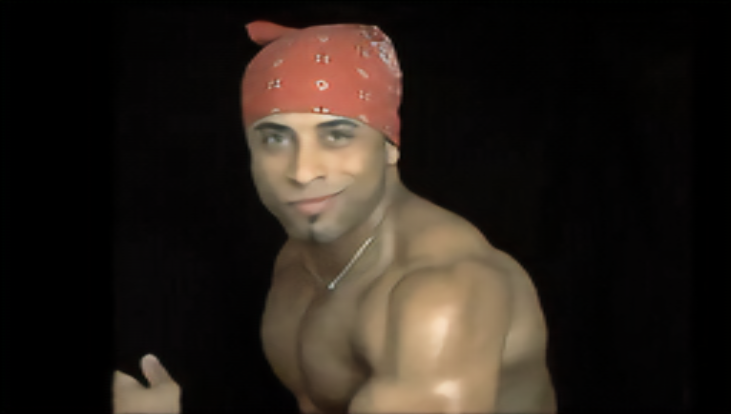

In [ ]:
img

Second time

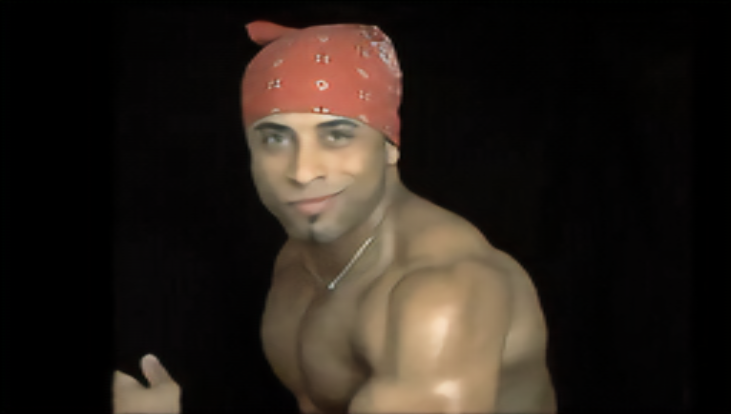

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

### Train again

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.655567,1.663269,3.058923,0.624788,9:14:50


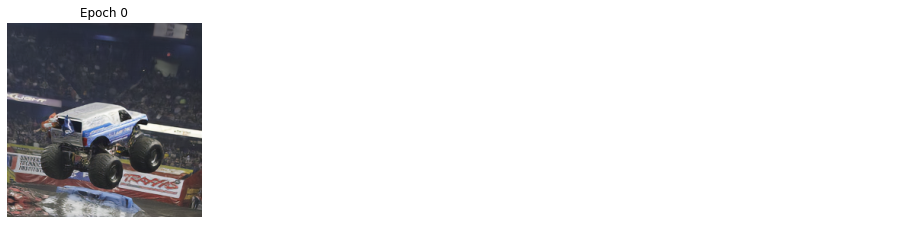

In [ ]:
learn.fit(1, lr/3)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-2")

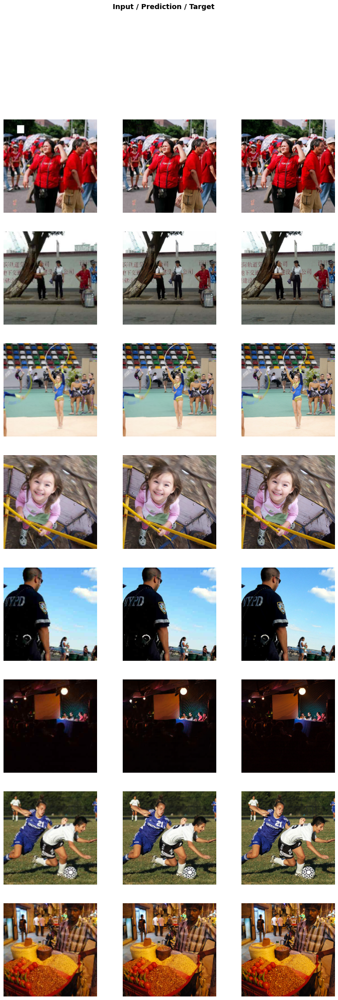

In [ ]:
learn.show_results(rows = 8)

In [ ]:
from google.colab import files
files.download("/content/SRGAN-2.pth") 

### Predict the second epoch

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-2")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

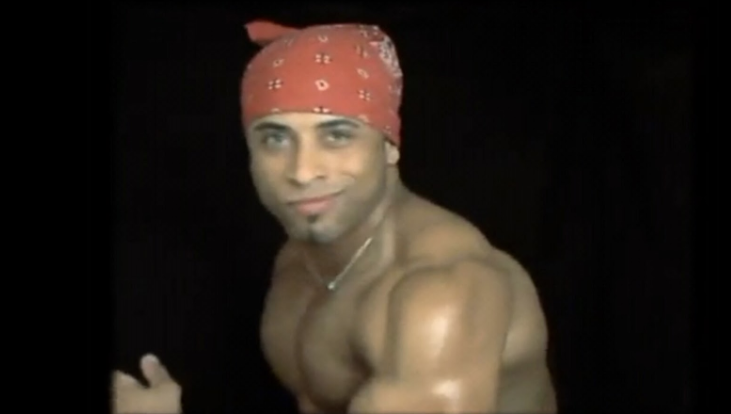

In [ ]:
img = open_image("/content/ricardo.png")
img

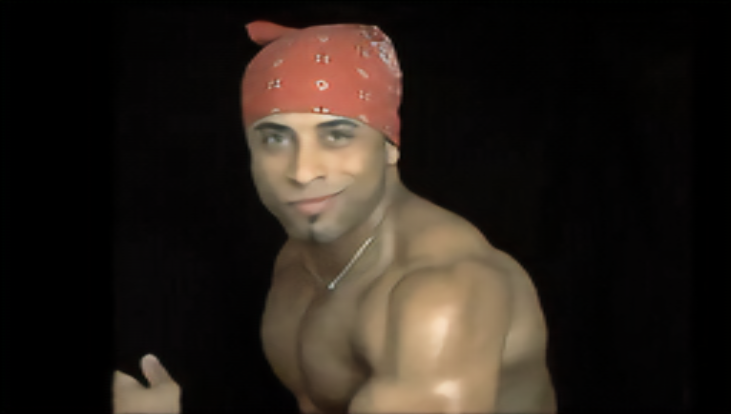

In [ ]:
learn.gen_mode = True
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

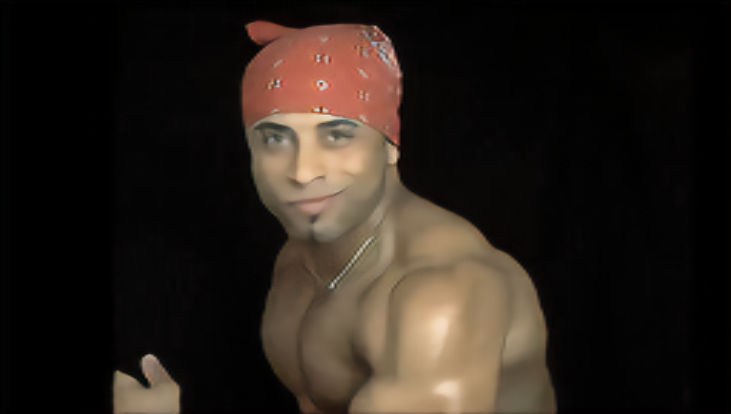

In [ ]:
learn.gen_mode = True
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

## Third epoch

In [ ]:
#learn.save("/content/SRGAN-2.pth")

### Train

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-2")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.607583,1.183368,2.977306,0.628924,8:36:28


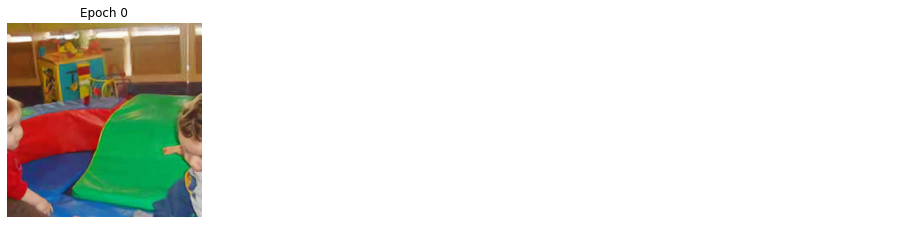

In [ ]:
learn.fit(1, lr/3)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-3")

### Predict the Third epoch

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-3")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

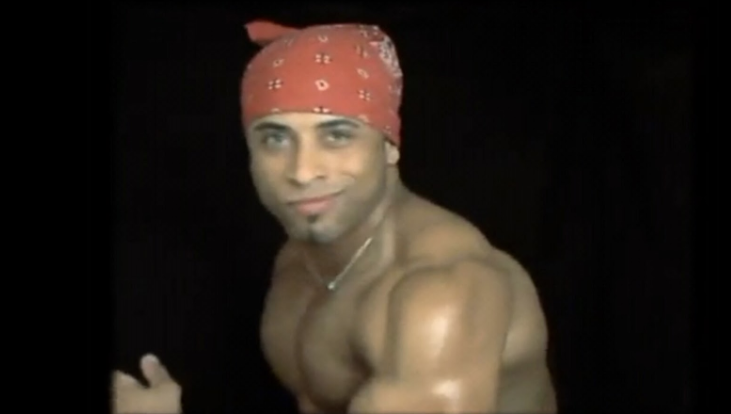

In [ ]:
img = open_image("/content/ricardo.png")
img

In [ ]:
original_size = img.shape

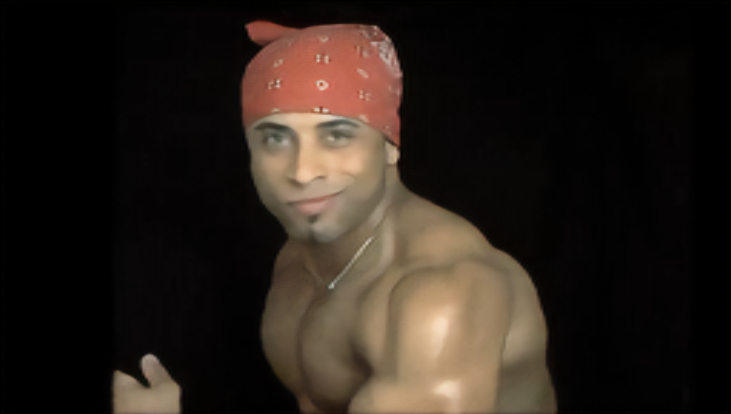

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

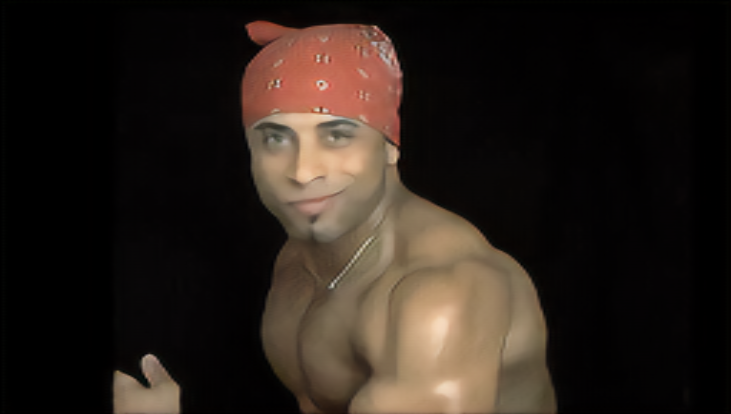

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

## Fourth epoch

### Train

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-3")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.613891,1.656889,2.965590,0.630214,8:49:26


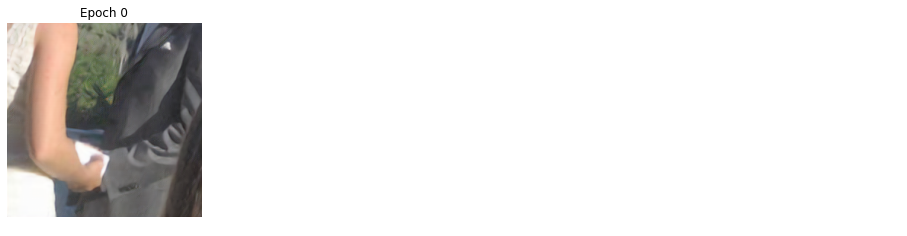

In [ ]:
learn.fit(1, lr/3)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-4")

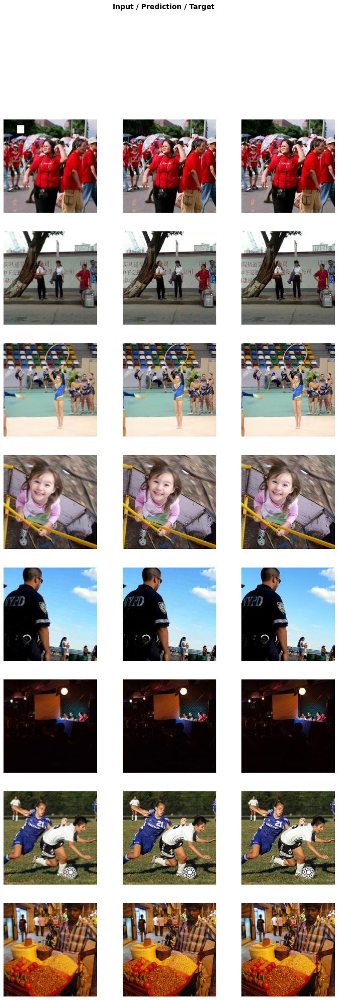

In [ ]:
learn.show_results(rows = 8)

### Predict

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-4")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

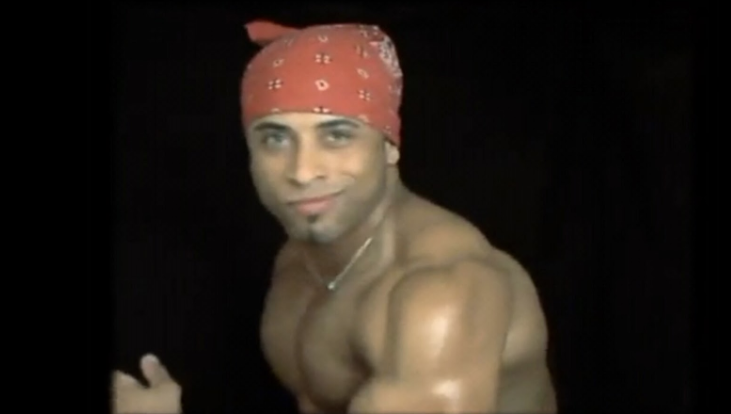

In [ ]:
img = open_image("/content/ricardo.png")
img

In [ ]:
original_size = img.shape

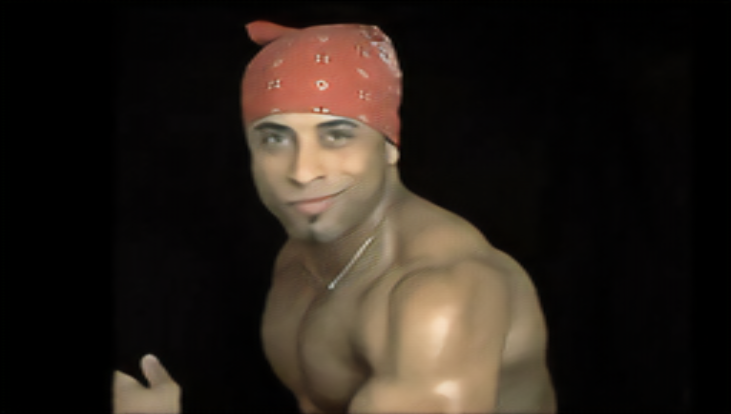

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

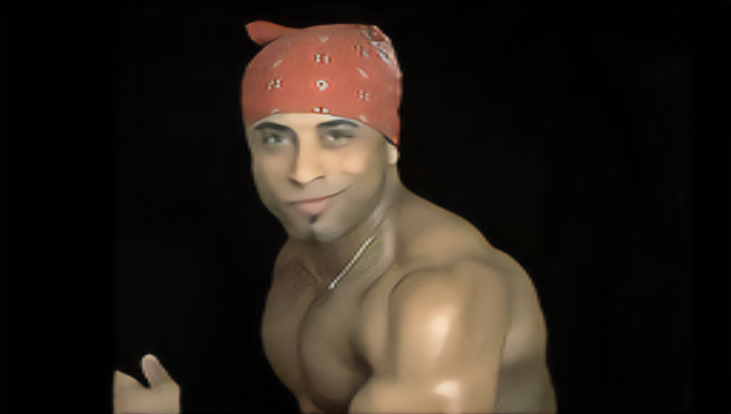

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

## Fifth epoch

### Train

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-4")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.755147,1.622920,3.014484,0.621579,8:51:30


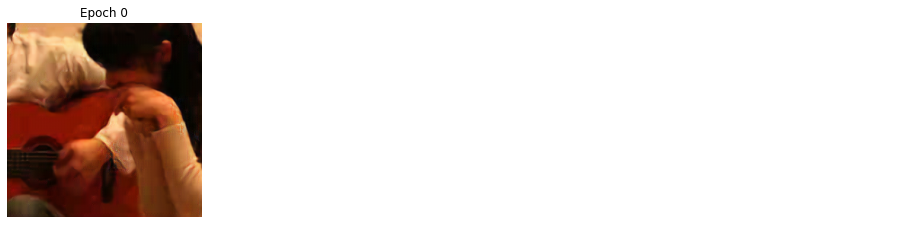

In [ ]:
learn.fit(1, lr/3)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-5")

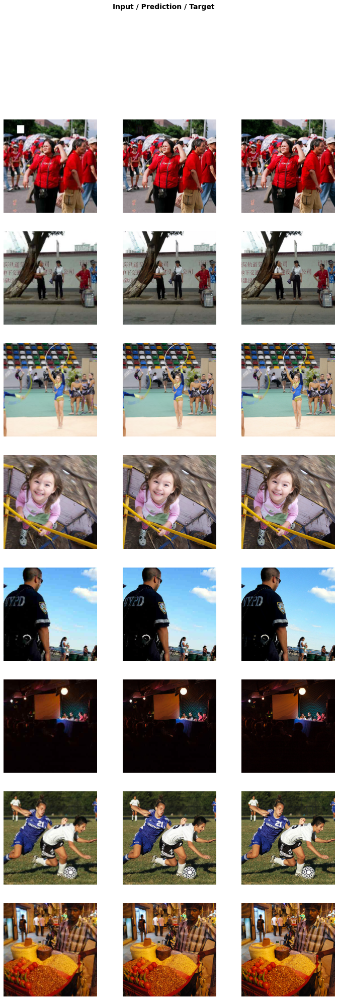

In [ ]:
learn.show_results(rows = 8)

### Predict

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-5")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

In [ ]:
img = None
pred = None

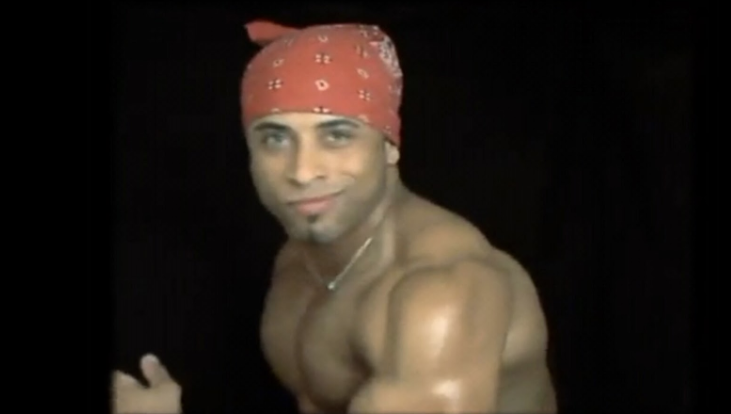

In [ ]:
img = open_image("/content/ricardo.png")
img

In [ ]:
original_size = img.shape

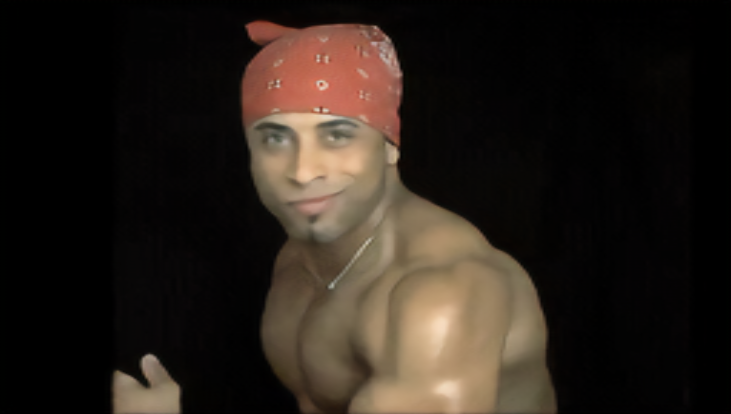

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

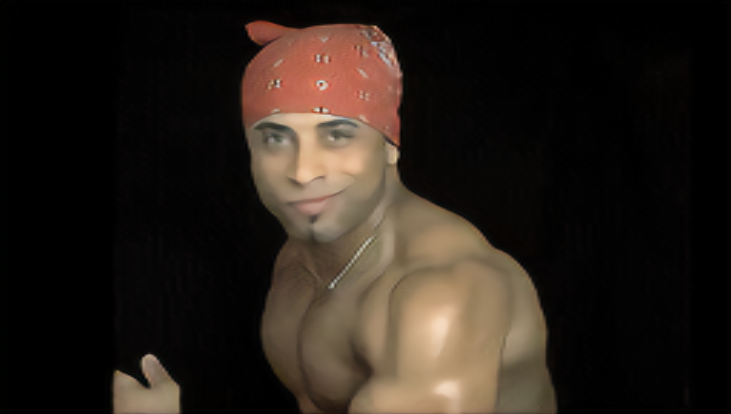

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

## Sixth epoch

### Train

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-5")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.763237,1.722260,3.047167,0.624894,8:11:28


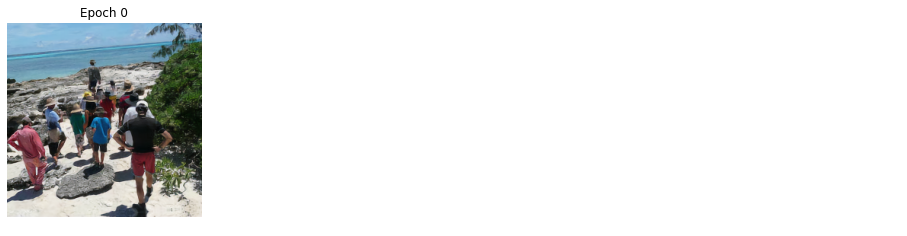

In [ ]:
learn.fit(1, lr/3)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-6")

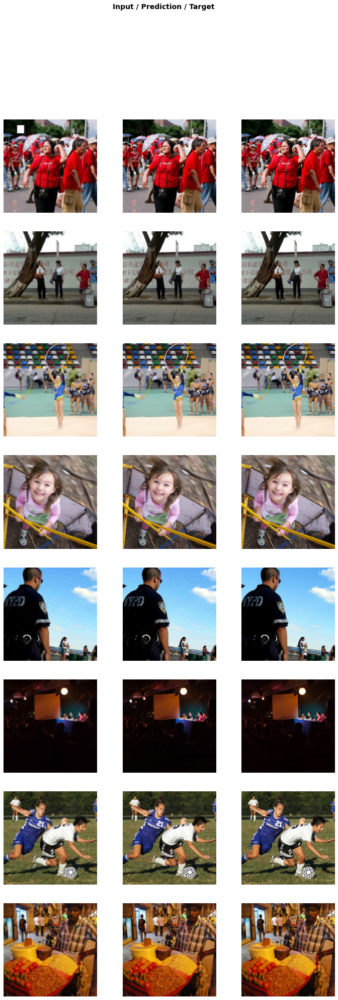

In [ ]:
learn.show_results(rows = 8)

### Predict

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-6")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

In [ ]:
img = None
pred = None

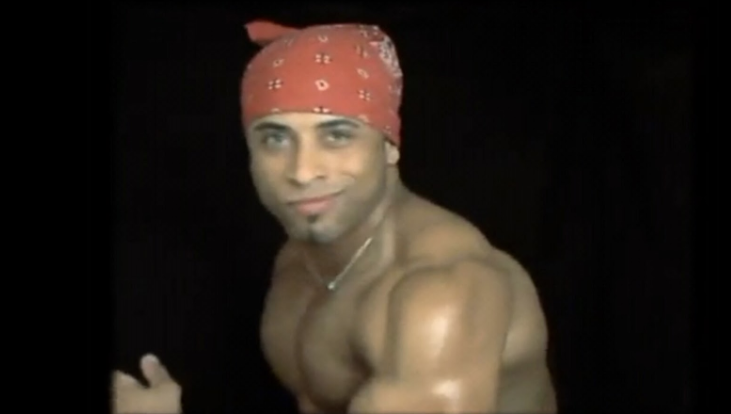

In [ ]:
img = open_image("/content/ricardo.png")
img

In [ ]:
original_size = img.shape

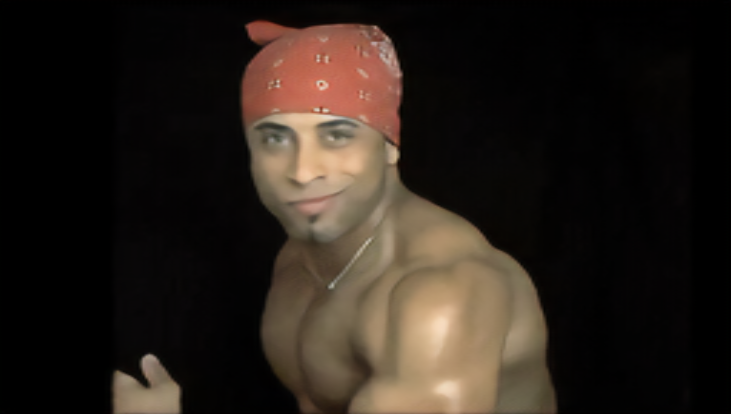

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

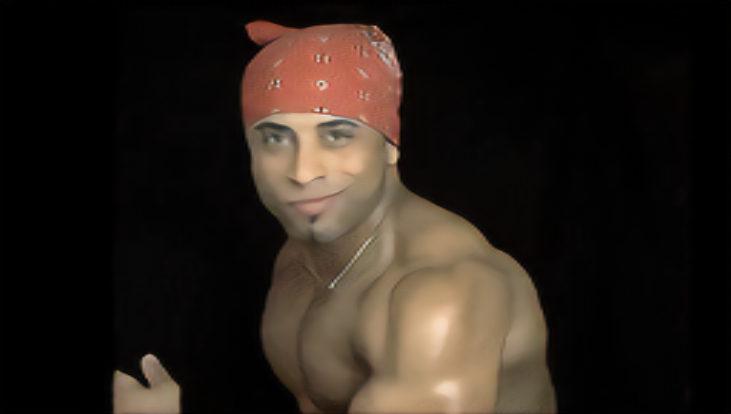

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

In [ ]:
img = None
pred = None

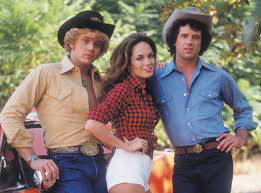

In [ ]:
img = open_image("/content/70s.jpg")
img

In [ ]:
original_size = img.shape

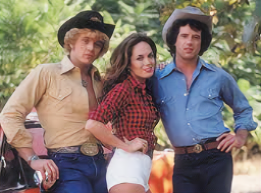

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

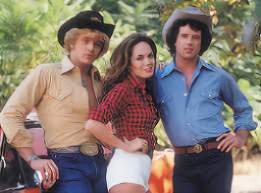

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

## Seventh epoch

### Train

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-6")

In [ ]:
learn.unfreeze()

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,1.815344,1.713831,2.993459,0.627486,7:55:10


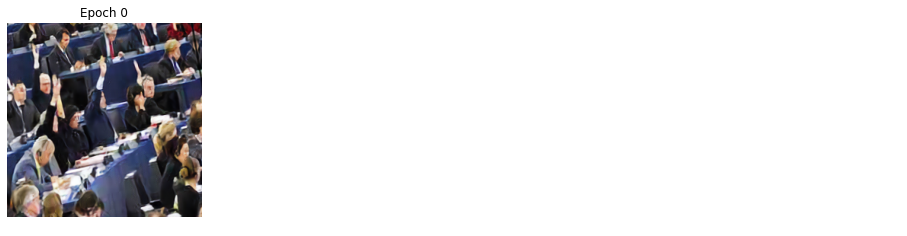

In [ ]:
learn.fit(1, lr)

In [ ]:
learn.save("/content/drive/My Drive/models/SRGAN-7")

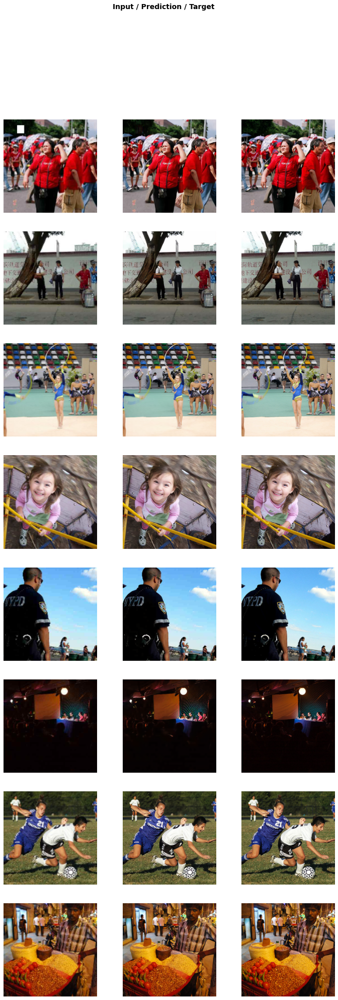

In [ ]:
learn.show_results(rows = 8)

### Predict

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-7")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
learn.unfreeze()

In [ ]:
img = None
pred = None

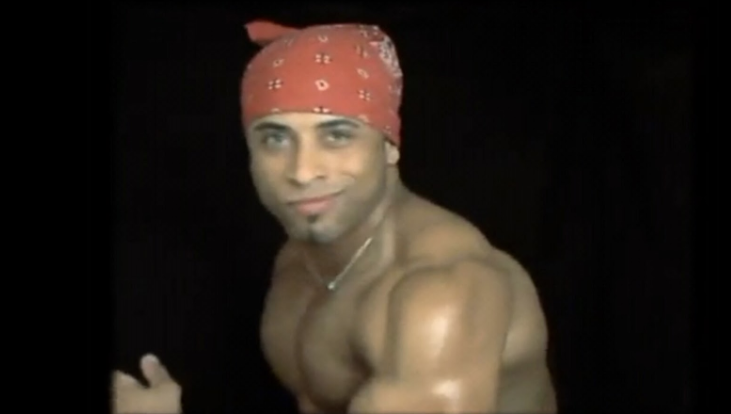

In [ ]:
img = open_image("/content/ricardo.png")
img

In [ ]:
original_size = img.shape

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

In [ ]:
img.save("/content/shitty.jpg")

In [ ]:
img = None
pred = None

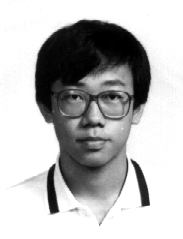

In [ ]:
img = open_image("/content/LIAO22.jpg")
img

In [ ]:
type(img)

fastai.vision.image.Image

In [ ]:
original_size = img.shape

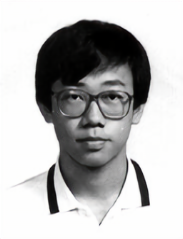

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

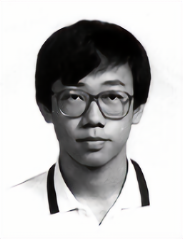

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

In [ ]:
img = None
pred = None

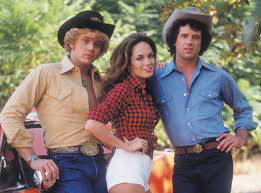

In [ ]:
img = open_image("/content/70s.jpg")
img

In [ ]:
type(img)

fastai.vision.image.Image

In [ ]:
original_size = img.shape

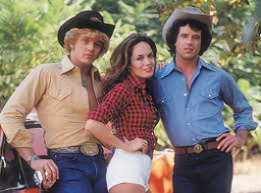

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

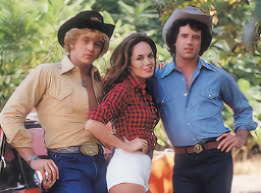

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

In [ ]:
img = None
pred = None

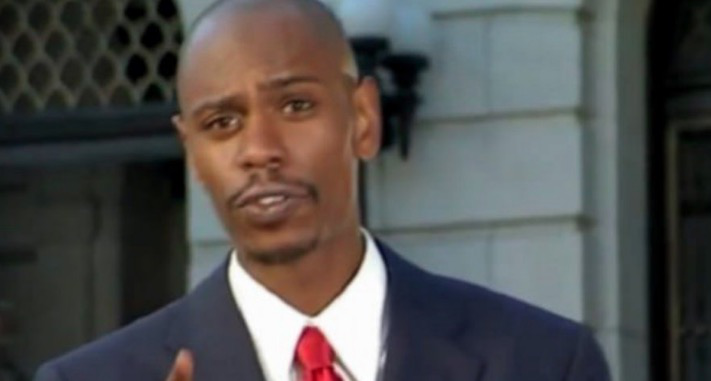

In [ ]:
img = open_image("/content/modern_problem.jpg")
img

In [ ]:
original_size = img.shape

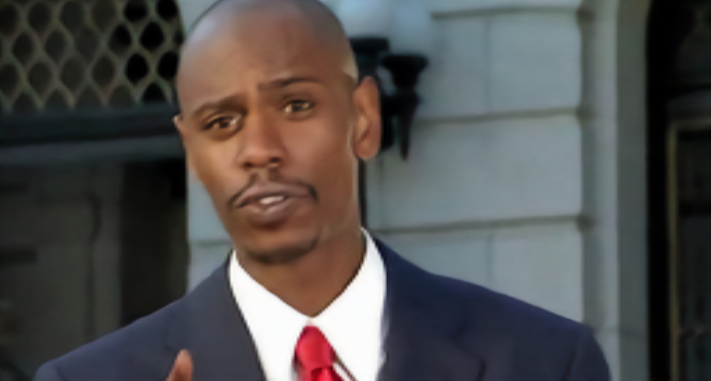

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

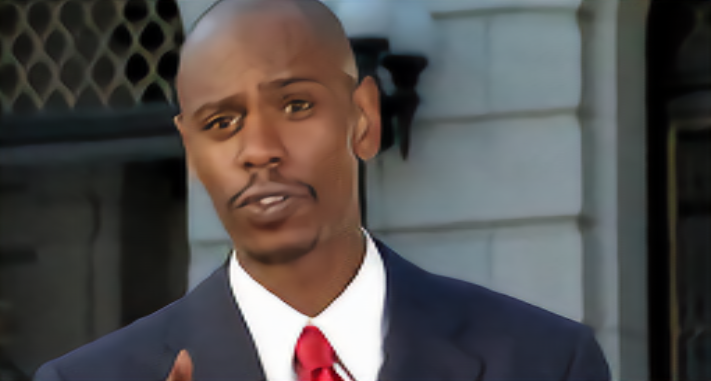

In [ ]:
pred = learner_gen.predict(img.resize((3, 256, 256)))
img = pred[0]
img.resize(original_size)

# Put the model in production

## Billy

In [ ]:
learn.load("/content/drive/My Drive/models/SRGAN-7")

GANLearner(data=ImageDataBunch;

Train: LabelList (28609 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Valid: LabelList (3178 items)
x: ImageImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/shitty_images_folder;

Test: None, model=GANModule(
  (generator): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxP

In [ ]:
!rm -rf "/content/video_frames"

In [ ]:
frame_path = Path("/content/video_frames")
frame_path.mkdir(exist_ok = True)

In [ ]:
vidcap = cv2.VideoCapture('/content/Billy_Herrington.flv')
success,image = vidcap.read()
count = 0
success = True
while success:
  success,img = vidcap.read()

  img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
  img = Image(pil2tensor(img, dtype=np.float32).div_(255))

  original_size = img.shape

  
  pred = learner_gen.predict(img.resize((3, 256, 256)))
  img = pred[0]
  img.resize(original_size)

  zero_add = 6 - len(str(count))

  img_name = "0"*zero_add + str(count) + ".png"

  img.save(frame_path/img_name) 

  count += 1

  if(count > 3000):
    break

In [ ]:
len(ImageList.from_folder("/content/video_frames").items)

3001

In [ ]:
#FPS=24
file_names = np.sort(glob.glob("/content/video_frames/*.png"))
img_array = []

for f_name in file_names:
  img = cv2.imread(f_name, cv2.IMREAD_COLOR)
  height, width, layers = img.shape
  size = (width,height)
  img_array.append(img)

out = cv2.VideoWriter("/content/HD_Billy.mp4", cv2.VideoWriter_fourcc(*'DIVX'), 24, size)

for i in range(len(img_array)):
  out.write(img_array[i])
out.release()


## DuDuDu

In [ ]:
!rm -rf "/content/video_frames"

In [ ]:
frame_path = Path("/content/video_frames")
frame_path.mkdir(exist_ok = True)

In [ ]:
vidcap = cv2.VideoCapture('/content/DuDuDu.mp4')
success,image = vidcap.read()
count = 0
success = True
while success:
  success,img = vidcap.read()

  img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
  img = Image(pil2tensor(img, dtype=np.float32).div_(255))

  original_size = img.shape

  
  pred = learner_gen.predict(img.resize((3, 256, 256)))
  img = pred[0]
  img.resize(original_size)

  zero_add = 6 - len(str(count))

  img_name = "0"*zero_add + str(count) + ".png"

  img.save(frame_path/img_name) 

  count += 1



In [ ]:
len(ImageList.from_folder("/content/video_frames").items)

501

In [ ]:
#FPS=24
file_names = np.sort(glob.glob("/content/video_frames/*.png"))
img_array = []

for f_name in file_names:
  img = cv2.imread(f_name, cv2.IMREAD_COLOR)
  height, width, layers = img.shape
  size = (width,height)
  img_array.append(img)

out = cv2.VideoWriter("/content/HD_DuDuDu.mp4", cv2.VideoWriter_fourcc(*'DIVX'), 24, size)

for i in range(len(img_array)):
  out.write(img_array[i])
out.release()
